In [245]:
suppressPackageStartupMessages(library(readxl))
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(tidyr))
suppressPackageStartupMessages(library(tibble))
suppressPackageStartupMessages(library(patchwork))
suppressPackageStartupMessages(library(pheatmap))
suppressPackageStartupMessages(library(stringr))
library(hise)
library(plyr)
library(purrr)
library(vegan)
#library(arrow)
library(rstatix)
library(parallel)
library(ggpubr)
library(ComplexHeatmap)
library(compositions)
library(ggsci)
library(math)
library(data.table)

ERROR: Error in library(compositions): there is no package called ‘compositions’


# Reading the file

In [72]:
mydata = fread("/home/jupyter/Myeloid_cells/files/All_Flu_timepoints_raw.csv", header = TRUE)

In [73]:
unique(mydata$sample.visitName)

[1] "Flu Year 1 Day 0"  "Flu Year 1 Day 7"  "Flu Year 1 Day 90"
[4] "Flu Year 2 Day 0"  "Flu Year 2 Day 7"  "Flu Year 2 Day 90"

In [58]:
unique(mydata$sample.visitDetails)

[1] "N/A - Flu-Series Timepoint Only"

In [48]:
colnames(mydata)

[1] "barcodes"                              
 [2] "barcodes"                              
 [3] "batch_id"                              
 [4] "cell_name"                             
 [5] "cell_uuid"                             
 [6] "chip_id"                               
 [7] "hto_barcode"                           
 [8] "hto_category"                          
 [9] "n_genes"                               
[10] "n_mito_umis"                           
[11] "n_reads"                               
[12] "n_umis"                                
[13] "original_barcodes"                     
[14] "pbmc_sample_id"                        
[15] "pool_id"                               
[16] "seurat_pbmc_type"                      
[17] "seurat_pbmc_type_score"                
[18] "umap_1"                                
[19] "umap_2"                                
[20] "well_id"                               
[21] "subject.biologicalSex"                 
[22] "subject.ethnicity"                     
[23] "subject.partnerCode"                   
[24] "subject.race"                          
[25] "subject.subjectGuid"                   
[26] "cohort.cohortGuid"                     
[27] "sample.visitName"                      
[28] "sample.visitDetails"                   
[29] "subject.birthYear"                     
[30] "CMV.IgG.Serology.Result.Interpretation"
[31] "BMI"                                   
[32] "predicted_doublet"                     
[33] "doublet_score"                         
[34] "AIFI_L1"                               
[35] "AIFI_L2"                               
[36] "AIFI_L3"                               
[37] "AIFI_L3.5"                             
[38] "n_genes_by_counts"                     
[39] "log1p_n_genes_by_counts"               
[40] "total_counts"                          
[41] "log1p_total_counts"                    
[42] "pct_counts_in_top_50_genes"            
[43] "pct_counts_in_top_100_genes"           
[44] "pct_counts_in_top_200_genes"           
[45] "pct_counts_in_top_500_genes"           
[46] "total_counts_mito"                     
[47] "log1p_total_counts_mito"               
[48] "pct_counts_mito"

In [74]:
# removing extra barcodes column
mydata <- subset(mydata, select = -barcodes)
head(mydata)

barcodes,batch_id,cell_name,cell_uuid,chip_id,hto_barcode,hto_category,n_genes,n_mito_umis,n_reads,⋯,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mito,log1p_total_counts_mito,pct_counts_mito
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<int>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
70ced6d648b611eaa65d9e7d578d66f2,B001,rhinestone_mannerly_argali,70ced6d648b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2965,354,54033,⋯,7.994970,15237,9.631548,38.82654,54.99770,65.89880,77.13461,354,5.872118,2.323292
70da1ed848b611eaa65d9e7d578d66f2,B001,ghastful_sphinxian_zopilote,70da1ed848b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2691,311,44212,⋯,7.898040,12929,9.467305,39.77106,55.07773,65.90610,77.05932,311,5.743003,2.405445
c67f8e0248bd11eab2ee7a6edf799b61,B001,feudal_respected_meadowhawk,c67f8e0248bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,2495,197,32319,⋯,7.822445,10139,9.224243,38.48506,50.99122,61.62343,74.08028,197,5.288267,1.942992
c6aba74448bd11eab2ee7a6edf799b61,B001,atrophied_piercing_piglet,c6aba74448bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,3620,663,61476,⋯,8.194506,18496,9.825364,35.21843,52.34105,63.07850,73.50779,663,6.498282,3.584559
5cfb5a3048b111ea8fbed2ddb8e0a14a,B001,absent_unsweet_chihuahua,5cfb5a3048b111ea8fbed2ddb8e0a14a,B001-P1C1,TGATGGCCTATTGGG,singlet,2974,466,38227,⋯,7.997999,13444,9.506363,35.79292,51.91907,62.68224,73.72806,466,6.146329,3.466230
6cc8428048b511ea87c666a4322bd84a,B001,unpacified_greenish_xanclomys,6cc8428048b511ea87c666a4322bd84a,B001-P1C1,TGATGGCCTATTGGG,singlet,2650,159,41769,⋯,7.882692,12027,9.394993,40.35919,52.97248,63.51542,75.67972,159,5.075174,1.322025


In [49]:
dict <- read.csv('/home/jupyter/Myeloid_cells/files/Dictionary_AIFI_Reference.csv')

In [195]:
## testing label organization
# Read the CSV file containing the desired labels
label_data <- read.csv("/home/jupyter/IH-A-Aging-Analysis-Notebooks/Mansi_Notebooks/scRNA/Frequency_Plot/Immune_Cell_Order_forDEGsummary - Sheet1.csv", header = TRUE)

# Extract the labels from the CSV file
desired_labels <- label_data$FINAL.ORDER




In [50]:
unique(mydata$cohort.cohortGuid)
#unique(flu_df$AIFI_L3.5)
#unique(flu_df$AIFI_L1)

[1] "BR1" "BR2"

In [75]:
nrow(mydata)

[1] 8277628

In [61]:
head(mydata)

barcodes,barcodes.1,batch_id,cell_name,cell_uuid,chip_id,hto_barcode,hto_category,n_genes,n_mito_umis,⋯,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mito,log1p_total_counts_mito,pct_counts_mito
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
70ced6d648b611eaa65d9e7d578d66f2,70ced6d648b611eaa65d9e7d578d66f2,B001,rhinestone_mannerly_argali,70ced6d648b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2965,354,⋯,7.994970,15237,9.631548,38.82654,54.99770,65.89880,77.13461,354,5.872118,2.323292
70da1ed848b611eaa65d9e7d578d66f2,70da1ed848b611eaa65d9e7d578d66f2,B001,ghastful_sphinxian_zopilote,70da1ed848b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2691,311,⋯,7.898040,12929,9.467305,39.77106,55.07773,65.90610,77.05932,311,5.743003,2.405445
c67f8e0248bd11eab2ee7a6edf799b61,c67f8e0248bd11eab2ee7a6edf799b61,B001,feudal_respected_meadowhawk,c67f8e0248bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,2495,197,⋯,7.822445,10139,9.224243,38.48506,50.99122,61.62343,74.08028,197,5.288267,1.942992
c6aba74448bd11eab2ee7a6edf799b61,c6aba74448bd11eab2ee7a6edf799b61,B001,atrophied_piercing_piglet,c6aba74448bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,3620,663,⋯,8.194506,18496,9.825364,35.21843,52.34105,63.07850,73.50779,663,6.498282,3.584559
5cfb5a3048b111ea8fbed2ddb8e0a14a,5cfb5a3048b111ea8fbed2ddb8e0a14a,B001,absent_unsweet_chihuahua,5cfb5a3048b111ea8fbed2ddb8e0a14a,B001-P1C1,TGATGGCCTATTGGG,singlet,2974,466,⋯,7.997999,13444,9.506363,35.79292,51.91907,62.68224,73.72806,466,6.146329,3.466230
6cc8428048b511ea87c666a4322bd84a,6cc8428048b511ea87c666a4322bd84a,B001,unpacified_greenish_xanclomys,6cc8428048b511ea87c666a4322bd84a,B001-P1C1,TGATGGCCTATTGGG,singlet,2650,159,⋯,7.882692,12027,9.394993,40.35919,52.97248,63.51542,75.67972,159,5.075174,1.322025


In [76]:
rownames(mydata)<-mydata$cell_uuid

# CLR transform

In [246]:
clr_transform <- function(x) {
  if (length(x) == 0) {
    return(NA)  # return NA for empty vectors
  }
  geom_mean <- exp(mean(log(x)))
  return(log(x / geom_mean))
}

# Data Transformation

In [247]:
head(mydata)

barcodes,batch_id,cell_name,cell_uuid,chip_id,hto_barcode,hto_category,n_genes,n_mito_umis,n_reads,⋯,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mito,log1p_total_counts_mito,pct_counts_mito
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<int>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
70ced6d648b611eaa65d9e7d578d66f2,B001,rhinestone_mannerly_argali,70ced6d648b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2965,354,54033,⋯,7.994970,15237,9.631548,38.82654,54.99770,65.89880,77.13461,354,5.872118,2.323292
70da1ed848b611eaa65d9e7d578d66f2,B001,ghastful_sphinxian_zopilote,70da1ed848b611eaa65d9e7d578d66f2,B001-P1C1,TGATGGCCTATTGGG,singlet,2691,311,44212,⋯,7.898040,12929,9.467305,39.77106,55.07773,65.90610,77.05932,311,5.743003,2.405445
c67f8e0248bd11eab2ee7a6edf799b61,B001,feudal_respected_meadowhawk,c67f8e0248bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,2495,197,32319,⋯,7.822445,10139,9.224243,38.48506,50.99122,61.62343,74.08028,197,5.288267,1.942992
c6aba74448bd11eab2ee7a6edf799b61,B001,atrophied_piercing_piglet,c6aba74448bd11eab2ee7a6edf799b61,B001-P1C1,TGATGGCCTATTGGG,singlet,3620,663,61476,⋯,8.194506,18496,9.825364,35.21843,52.34105,63.07850,73.50779,663,6.498282,3.584559
5cfb5a3048b111ea8fbed2ddb8e0a14a,B001,absent_unsweet_chihuahua,5cfb5a3048b111ea8fbed2ddb8e0a14a,B001-P1C1,TGATGGCCTATTGGG,singlet,2974,466,38227,⋯,7.997999,13444,9.506363,35.79292,51.91907,62.68224,73.72806,466,6.146329,3.466230
6cc8428048b511ea87c666a4322bd84a,B001,unpacified_greenish_xanclomys,6cc8428048b511ea87c666a4322bd84a,B001-P1C1,TGATGGCCTATTGGG,singlet,2650,159,41769,⋯,7.882692,12027,9.394993,40.35919,52.97248,63.51542,75.67972,159,5.075174,1.322025


In [63]:
colnames(mydata)

[1] "barcodes"                              
 [2] "barcodes"                              
 [3] "batch_id"                              
 [4] "cell_name"                             
 [5] "cell_uuid"                             
 [6] "chip_id"                               
 [7] "hto_barcode"                           
 [8] "hto_category"                          
 [9] "n_genes"                               
[10] "n_mito_umis"                           
[11] "n_reads"                               
[12] "n_umis"                                
[13] "original_barcodes"                     
[14] "pbmc_sample_id"                        
[15] "pool_id"                               
[16] "seurat_pbmc_type"                      
[17] "seurat_pbmc_type_score"                
[18] "umap_1"                                
[19] "umap_2"                                
[20] "well_id"                               
[21] "subject.biologicalSex"                 
[22] "subject.ethnicity"                     
[23] "subject.partnerCode"                   
[24] "subject.race"                          
[25] "subject.subjectGuid"                   
[26] "cohort.cohortGuid"                     
[27] "sample.visitName"                      
[28] "sample.visitDetails"                   
[29] "subject.birthYear"                     
[30] "CMV.IgG.Serology.Result.Interpretation"
[31] "BMI"                                   
[32] "predicted_doublet"                     
[33] "doublet_score"                         
[34] "AIFI_L1"                               
[35] "AIFI_L2"                               
[36] "AIFI_L3"                               
[37] "AIFI_L3.5"                             
[38] "n_genes_by_counts"                     
[39] "log1p_n_genes_by_counts"               
[40] "total_counts"                          
[41] "log1p_total_counts"                    
[42] "pct_counts_in_top_50_genes"            
[43] "pct_counts_in_top_100_genes"           
[44] "pct_counts_in_top_200_genes"           
[45] "pct_counts_in_top_500_genes"           
[46] "total_counts_mito"                     
[47] "log1p_total_counts_mito"               
[48] "pct_counts_mito"

In [462]:
## Percentage of total

result <- mydata %>%
  dplyr::group_by(AIFI_L3, subject.subjectGuid, sample.visitName ) %>%               
  dplyr::summarise(count = n()) %>%                  # Count occurrences
  dplyr::group_by(subject.subjectGuid, ) %>%                       
  dplyr::mutate(percentage = (count / sum(count)) * 100) %>% 
  dplyr::group_by(subject.subjectGuid, ) %>%     
  dplyr::mutate(percentage_clr = clr_transform((percentage))) %>% # Group again by subjectGuid for CLR# Calculate percentage
  dplyr::ungroup()

head(result)
#sum(result$subject.subjectGuid)

`summarise()` has grouped output by 'AIFI_L3', 'subject.subjectGuid'. You can
override using the `.groups` argument.


AIFI_L3,subject.subjectGuid,sample.visitName,count,percentage,percentage_clr
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>
ASDC,BR1001,Flu Year 1 Day 0,6,0.012381345,-2.014465
ASDC,BR1001,Flu Year 1 Day 7,5,0.010317788,-2.196787
ASDC,BR1001,Flu Year 1 Day 90,3,0.006190673,-2.707612
ASDC,BR1002,Flu Year 1 Day 0,3,0.003233525,-2.497984
ASDC,BR1002,Flu Year 1 Day 7,2,0.002155683,-2.903449
ASDC,BR1002,Flu Year 1 Day 90,2,0.002155683,-2.903449


In [463]:
result %>% filter(subject.subjectGuid == "BR1001") %>% 
      select(percentage) %>%
      pull() %>% 
      sum()

[1] 100

In [464]:
nrow(result)

[1] 34833

In [465]:
#library(dplyr)

# Assuming 'result' is one dataframe and 'mydata' is another dataframe

# Extracting unique columns from mydata
unique_mydata <- mydata %>%
  select(cohort.cohortGuid, subject.subjectGuid, subject.biologicalSex, CMV.IgG.Serology.Result.Interpretation) %>%
  unique()

# Performing inner join
result <- inner_join(result, unique_mydata, by = 'subject.subjectGuid')


In [466]:
result$AIFI_L3 <- gsub("Core naive CD8 T cell ", "Core naive CD8 T cell", result$AIFI_L3 )

In [467]:
filtered_data <- result %>%
  group_by(AIFI_L3,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 1 Day 7", "Flu Year 1 Day 90", "Flu Year 2 Day 0", "Flu Year 2 Day 7", "Flu Year 2 Day 90") %in% sample.visitName))

head(filtered_data)


AIFI_L3,subject.subjectGuid,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>
ASDC,BR1002,Flu Year 1 Day 0,3,0.003233525,-2.497984,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 7,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 90,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 0,3,0.003233525,-2.497984,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 7,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 90,3,0.003233525,-2.497984,BR1,Male,Negative


In [253]:
unique(result$AIFI_L3)

[1] "ASDC"                                
 [2] "Activated memory B cell"             
 [3] "Adaptive NK cell"                    
 [4] "BaEoMaP cell"                        
 [5] "C1Q+ CD16 monocyte"                  
 [6] "CD14+ cDC2"                          
 [7] "CD27+ effector B cell"               
 [8] "CD27- effector B cell"               
 [9] "CD4 MAIT"                            
[10] "CD56bright NK cell"                  
[11] "CD8 MAIT"                            
[12] "CD8aa"                               
[13] "CD95 memory B cell"                  
[14] "CLP cell"                            
[15] "CM CD4 T cell"                       
[16] "CM CD8 T cell"                       
[17] "CMP cell"                            
[18] "Core CD14 monocyte"                  
[19] "Core CD16 monocyte"                  
[20] "Core memory B cell"                  
[21] "Core naive B cell"                   
[22] "Core naive CD4 T cell"               
[23] "Core naive CD8 T cell"               
[24] "DN T cell"                           
[25] "Early memory B cell"                 
[26] "Erythrocyte"                         
[27] "GZMB+ Vd2 gdT"                       
[28] "GZMB- CD27+ EM CD4 T cell"           
[29] "GZMB- CD27- EM CD4 T cell"           
[30] "GZMK+ CD27+ EM CD8 T cell"           
[31] "GZMK+ CD56dim NK cell"               
[32] "GZMK+ Vd2 gdT"                       
[33] "GZMK+ memory CD4 Treg"               
[34] "GZMK- CD27+ EM CD8 T cell"           
[35] "GZMK- CD56dim NK cell"               
[36] "HLA-DRhi cDC2"                       
[37] "IL1B+ CD14 monocyte"                 
[38] "ILC"                                 
[39] "ISG+ CD14 monocyte"                  
[40] "ISG+ CD16 monocyte"                  
[41] "ISG+ CD56dim NK cell"                
[42] "ISG+ MAIT"                           
[43] "ISG+ cDC2"                           
[44] "ISG+ memory CD4 T cell"              
[45] "ISG+ memory CD8 T cell"              
[46] "ISG+ naive B cell"                   
[47] "ISG+ naive CD4 T cell"               
[48] "ISG+ naive CD8 T cell"               
[49] "Intermediate monocyte"               
[50] "KLRB1+ memory CD4 Treg"              
[51] "KLRB1+ memory CD8 Treg"              
[52] "KLRF1+ GZMB+ CD27- EM CD8 T cell"    
[53] "KLRF1+ effector Vd1 gdT"             
[54] "KLRF1- GZMB+ CD27- EM CD8 T cell"    
[55] "KLRF1- GZMB+ CD27- memory CD4 T cell"
[56] "KLRF1- effector Vd1 gdT"             
[57] "Memory CD4 Treg"                     
[58] "Memory CD8 Treg"                     
[59] "Naive CD4 Treg"                      
[60] "Naive Vd1 gdT"                       
[61] "Plasma cell"                         
[62] "Platelet"                            
[63] "Proliferating NK cell"               
[64] "Proliferating T cell"                
[65] "SOX4+ Vd1 gdT"                       
[66] "SOX4+ naive CD4 T cell"              
[67] "SOX4+ naive CD8 T cell"              
[68] "Transitional B cell"                 
[69] "Type 2 polarized memory B cell"      
[70] "cDC1"                                
[71] "pDC"

# Linear mixed model

In [256]:
library(lme4)       # linear mixed-effects models
#library(lmerTest) 
library(ggplot2)

# Assuming your data is in a dataframe named 'longitudinal_data'

# Fit a linear mixed model
lmm <- lmer(outcome_variable ~ timepoint + Age + (1 | subject_id), data = longitudinal_data)

# Plot the longitudinal data
ggplot(longitudinal_data, aes(x = flu_timepoint, y = outcome_variable, group = Age, color = Age)) +
  geom_line() +
  geom_point() +
  labs(x = "Flu Timepoint", y = "Outcome Variable") +
  theme_minimal() +
  geom_smooth(method = "lm", se = FALSE, linetype = "dashed") +  # Add linear trend lines
  geom_smooth(method = "predict", formula = lmm, se = FALSE) +  # Add model predictions
  scale_color_manual(values = c("BR1" = "blue", "BR2" = "red")) +  # Specify line colors
  theme(legend.position = "top")  # Move legend to the top


In [400]:
#extracting only Flu year 1 timepoints
result_yr1 <- mydata %>% filter(sample.visitName == "Flu Year 1 Day 0" | sample.visitName == "Flu Year 1 Day 7" |sample.visitName == "Flu Year 1 Day 90")
unique(result_yr1$sample.visitName)

[1] "Flu Year 1 Day 0"  "Flu Year 1 Day 7"  "Flu Year 1 Day 90"

In [401]:
# Create a numeric column based on timepoint
result_yr1$day_numeric <- ifelse(result_yr1$sample.visitName == 'Flu Year 1 Day 0', 0,
                             ifelse(result_yr1$sample.visitName == 'Flu Year 1 Day 7', 7,
                                    ifelse(result_yr1$sample.visitName == 'Flu Year 1 Day 90', 90, NA)))

# Print the modified dataframe
unique(result_yr1$sample.visitName)
unique(result_yr1$day_numeric)
nrow(result_yr1)
#head(result_yr1)

[1] "Flu Year 1 Day 0"  "Flu Year 1 Day 7"  "Flu Year 1 Day 90"

[1]  0  7 90

[1] 4404120

In [402]:
#filter the df for only paired samples in all timepoints
result_yr1_v2 <- result_yr1 %>%
  group_by(AIFI_L3,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 1 Day 7", "Flu Year 1 Day 90") %in% sample.visitName))

nrow(result_yr1_v2)

[1] 3953359

## Data transformation

In [443]:
## Percentage of total

long <- result_yr1_v2 %>%
  dplyr::group_by(AIFI_L3, subject.subjectGuid, day_numeric, sample.visitName ) %>%               
  dplyr::summarise(count = n()) %>%                  # Count occurrences
  dplyr::group_by(subject.subjectGuid, ) %>%                       
  dplyr::mutate(percentage = (count / sum(count)) * 100) %>% 
  dplyr::group_by(subject.subjectGuid, ) %>%     
  dplyr::mutate(percentage_clr = clr_transform((percentage))) %>% # Group again by subjectGuid for CLR# Calculate percentage
  dplyr::ungroup()

head(long)
#sum(result$subject.subjectGuid)

`summarise()` has grouped output by 'AIFI_L3', 'subject.subjectGuid',
'day_numeric'. You can override using the `.groups` argument.


AIFI_L3,subject.subjectGuid,day_numeric,sample.visitName,count,percentage,percentage_clr
<chr>,<chr>,<dbl>,<chr>,<int>,<dbl>,<dbl>
ASDC,BR1001,0,Flu Year 1 Day 0,6,0.012383901,-2.035581
ASDC,BR1001,7,Flu Year 1 Day 7,5,0.010319917,-2.217903
ASDC,BR1001,90,Flu Year 1 Day 90,3,0.006191950,-2.728729
ASDC,BR1002,0,Flu Year 1 Day 0,3,0.006470817,-2.560362
ASDC,BR1002,7,Flu Year 1 Day 7,2,0.004313878,-2.965827
ASDC,BR1002,90,Flu Year 1 Day 90,2,0.004313878,-2.965827


In [385]:
long %>% filter(subject.subjectGuid == "BR1001") %>% 
      select(percentage) %>%
      pull() %>% 
      sum()

[1] 100

In [386]:
nrow(long)

[1] 15504

In [444]:
# Extracting unique columns from mydata
unique_mydata <- mydata %>%
  select(cohort.cohortGuid, subject.subjectGuid, subject.biologicalSex, CMV.IgG.Serology.Result.Interpretation) %>%
  unique()

# Performing inner join
long <- inner_join(long, unique_mydata, by = 'subject.subjectGuid')

long$AIFI_L3 <- gsub("Core naive CD8 T cell ", "Core naive CD8 T cell", long$AIFI_L3 )
nrow(long)
# filtered_data <- long %>%
#   group_by(AIFI_L3,subject.subjectGuid) %>%
#   filter(all(c("Flu Year 1 Day 0", "Flu Year 1 Day 7", "Flu Year 1 Day 90") %in% sample.visitName))

# head(filtered_data)

[1] 15504

## Plotting

In [ ]:
# # Aggregate data to calculate mean and confidence intervals
# summary_df <- result %>%
#   dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
#   dplyr::summarise(mean_percentage = mean(percentage),
#             ci_low = mean_percentage - 1.96 * sd(percentage) / sqrt(n()),
#             ci_high = mean_percentage + 1.96 * sd(percentage) / sqrt(n()))

# summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# # Plot with confidence intervals
# options(repr.plot.width = 40, repr.plot.height = 50)
# ggplot(summary_df, aes(x = sample.visitName, y = mean_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
#   geom_line() +
#   theme_minimal() +
#   geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = AIFI_L3), alpha = 0.3, fill = "grey80") +
#   scale_color_manual(values = c("BR1" = "blue", "BR2" = "red")) + 
#   theme(strip.text = element_text(size = 15),
#                 axis.text.x = element_text(color = "black",
#                                            size = 15,
#                                            angle = 90,
#                                            hjust = 1,
#                                            vjust = 0.5),
#                 axis.text.y = element_text(color = "black", size = 15),
#                 axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
#                 axis.title.y = element_text(size = 14),
#                 legend.position = "right")+
#   labs(x = "Sample Visit Name", y = "Mean Percentage", color = "AIFI_L3") + 
#   facet_wrap(~ AIFI_L3, scales = 'free')


In [445]:
head(long)

AIFI_L3,subject.subjectGuid,day_numeric,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation
<chr>,<chr>,<dbl>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>
ASDC,BR1001,0,Flu Year 1 Day 0,6,0.012383901,-2.035581,BR1,Female,Negative
ASDC,BR1001,7,Flu Year 1 Day 7,5,0.010319917,-2.217903,BR1,Female,Negative
ASDC,BR1001,90,Flu Year 1 Day 90,3,0.006191950,-2.728729,BR1,Female,Negative
ASDC,BR1002,0,Flu Year 1 Day 0,3,0.006470817,-2.560362,BR1,Male,Negative
ASDC,BR1002,7,Flu Year 1 Day 7,2,0.004313878,-2.965827,BR1,Male,Negative
ASDC,BR1002,90,Flu Year 1 Day 90,2,0.004313878,-2.965827,BR1,Male,Negative


In [446]:
summary_df <- long %>%
  dplyr::group_by(AIFI_L3, sample.visitName, day_numeric, cohort.cohortGuid, subject.subjectGuid ) %>%
  dplyr::mutate(median_percentage = median(percentage),)

In [447]:
summary_df

AIFI_L3,subject.subjectGuid,day_numeric,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation,median_percentage
<chr>,<chr>,<dbl>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>
ASDC,BR1001,0,Flu Year 1 Day 0,6,0.012383901,-2.035581,BR1,Female,Negative,0.012383901
ASDC,BR1001,7,Flu Year 1 Day 7,5,0.010319917,-2.217903,BR1,Female,Negative,0.010319917
ASDC,BR1001,90,Flu Year 1 Day 90,3,0.006191950,-2.728729,BR1,Female,Negative,0.006191950
ASDC,BR1002,0,Flu Year 1 Day 0,3,0.006470817,-2.560362,BR1,Male,Negative,0.006470817
ASDC,BR1002,7,Flu Year 1 Day 7,2,0.004313878,-2.965827,BR1,Male,Negative,0.004313878
ASDC,BR1002,90,Flu Year 1 Day 90,2,0.004313878,-2.965827,BR1,Male,Negative,0.004313878
ASDC,BR1003,0,Flu Year 1 Day 0,4,0.008262244,-2.537901,BR1,Female,Negative,0.008262244
ASDC,BR1003,7,Flu Year 1 Day 7,1,0.002065561,-3.924195,BR1,Female,Negative,0.002065561
ASDC,BR1003,90,Flu Year 1 Day 90,1,0.002065561,-3.924195,BR1,Female,Negative,0.002065561


In [448]:
cell_df <- summary_df[summary_df$AIFI_L3 == "Plasma cell", ]
nrow(cell_df)

filtered_data_cell <- cell_df %>%
  group_by(AIFI_L3,subject.subjectGuid) %>%
  filter(all(c("0", "7", "90") %in% day_numeric))

[1] 225

In [449]:
cell_df

AIFI_L3,subject.subjectGuid,day_numeric,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation,median_percentage
<chr>,<chr>,<dbl>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>
Plasma cell,BR1001,0,Flu Year 1 Day 0,19,0.039215686,-0.88290184,BR1,Female,Negative,0.039215686
Plasma cell,BR1001,7,Flu Year 1 Day 7,17,0.035087719,-0.99412747,BR1,Female,Negative,0.035087719
Plasma cell,BR1001,90,Flu Year 1 Day 90,47,0.097007224,0.02280679,BR1,Female,Negative,0.097007224
Plasma cell,BR1002,0,Flu Year 1 Day 0,9,0.019412450,-1.46174985,BR1,Male,Negative,0.019412450
Plasma cell,BR1002,7,Flu Year 1 Day 7,14,0.030197144,-1.01991710,BR1,Male,Negative,0.030197144
Plasma cell,BR1002,90,Flu Year 1 Day 90,6,0.012941633,-1.86721496,BR1,Male,Negative,0.012941633
Plasma cell,BR1003,0,Flu Year 1 Day 0,12,0.024786731,-1.43928842,BR1,Female,Negative,0.024786731
Plasma cell,BR1003,7,Flu Year 1 Day 7,37,0.076425753,-0.31327716,BR1,Female,Negative,0.076425753
Plasma cell,BR1003,90,Flu Year 1 Day 90,11,0.022721170,-1.52629980,BR1,Female,Negative,0.022721170


In [407]:
# cell_df <- summary_df[summary_df$AIFI_L3 == "Plasma cell", ]
# nrow(cell_df)

# filtered_data_cell <- cell_df %>%
#   group_by(AIFI_L3,subject.subjectGuid) %>%
#   filter(all(c("0", "7", "90") %in% day_numeric))

# head(cell_df)
# nrow(cell_df)

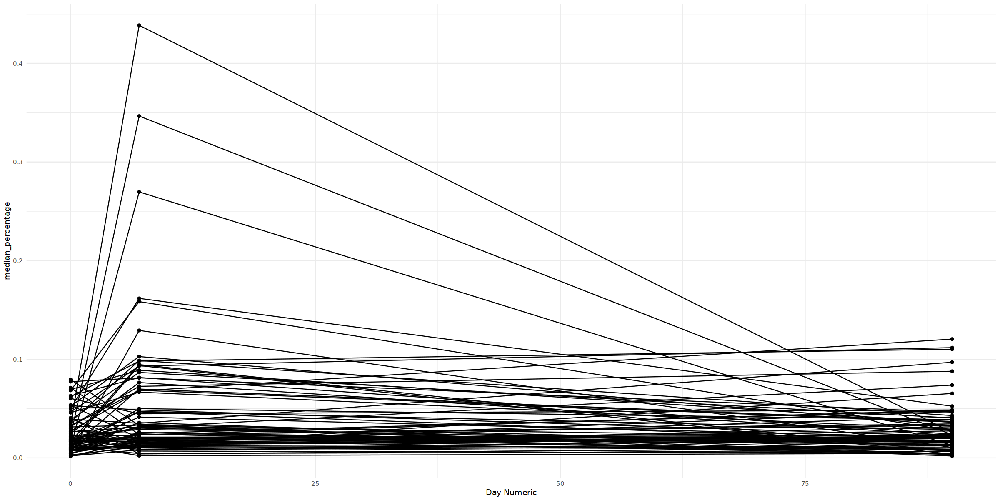

In [394]:
library(ggplot2)

# Assuming your dataframe is named 'mydata'

# Plot longitudinal data
options(repr.plot.width = 20, repr.plot.height = 10)
ggplot(cell_df, aes(x = day_numeric, y = median_percentage, group = subject.subjectGuid)) +
  geom_line() +
  geom_point() +
  labs(x = "Day Numeric", y = "median_percentage") +
  theme_minimal()



In [450]:
stat_test<- filtered_data_cell %>%
  select(median_percentage, AIFI_L3, cohort.cohortGuid, day_numeric,sample.visitName ) %>%
  unique(.) %>%
  group_by(AIFI_L3 ) %>%
  wilcox_test(median_percentage ~ day_numeric, paired= TRUE) %>%
  adjust_pvalue(method = "BH") %>%
  add_significance()

head(stat_test)

Adding missing grouping variables: `subject.subjectGuid`


AIFI_L3,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Plasma cell,median_percentage,0,7,75,75,511,2.37e-06,7.11e-06,****
Plasma cell,median_percentage,0,90,75,75,1157,3.80e-01,3.80e-01,ns
Plasma cell,median_percentage,7,90,75,75,1962,2.00e-03,3.00e-03,**


Adding missing grouping variables: `subject.subjectGuid`
`summarise()` has grouped output by 'AIFI_L3', 'day_numeric'. You can override
using the `.groups` argument.


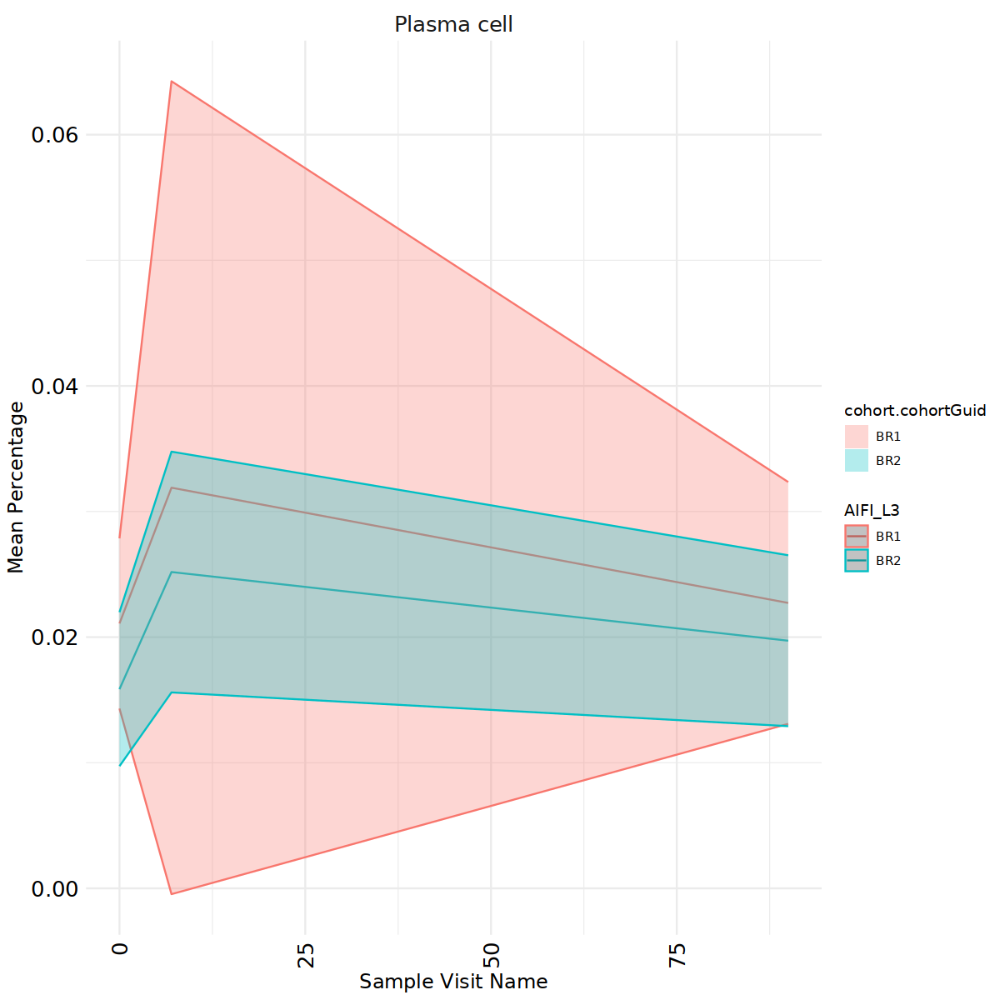

In [456]:
# Aggregate data to calculate mean and confidence intervals
stat_test<- filtered_data_cell %>%
  select(median_percentage, AIFI_L3, cohort.cohortGuid, day_numeric,sample.visitName ) %>%
  unique(.) %>%
  group_by(AIFI_L3 ) %>%
  wilcox_test(median_percentage ~ day_numeric, paired= TRUE) %>%
  adjust_pvalue(method = "BH") %>%
  add_significance()

summary_df <- cell_df %>%
  dplyr::group_by(AIFI_L3, day_numeric,cohort.cohortGuid ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width = 10, repr.plot.height = 10)
ggplot(summary_df, aes(x = day_numeric, y = median_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = cohort.cohortGuid), alpha = 0.3) +
  #scale_color_manual(values = c("Male" = "blue", "Female" = "violet")) + 
  theme(strip.text = element_text(size = 15),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Mean Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free')


In [454]:
head(cell_df)
head(plot_summary)

AIFI_L3,subject.subjectGuid,day_numeric,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation,median_percentage
<chr>,<chr>,<dbl>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>
Plasma cell,BR1001,0,Flu Year 1 Day 0,19,0.03921569,-0.88290184,BR1,Female,Negative,0.03921569
Plasma cell,BR1001,7,Flu Year 1 Day 7,17,0.03508772,-0.99412747,BR1,Female,Negative,0.03508772
Plasma cell,BR1001,90,Flu Year 1 Day 90,47,0.09700722,0.02280679,BR1,Female,Negative,0.09700722
Plasma cell,BR1002,0,Flu Year 1 Day 0,9,0.01941245,-1.46174985,BR1,Male,Negative,0.01941245
Plasma cell,BR1002,7,Flu Year 1 Day 7,14,0.03019714,-1.01991710,BR1,Male,Negative,0.03019714
Plasma cell,BR1002,90,Flu Year 1 Day 90,6,0.01294163,-1.86721496,BR1,Male,Negative,0.01294163


AIFI_L3,day_numeric,cohort.cohortGuid,ci_low,ci_high,plot_summary
<chr>,<dbl>,<chr>,<dbl>,<dbl>,<fct>
Plasma cell,0,BR1,0.032442604,0.04598877,Plasma cell
Plasma cell,0,BR1,0.012639367,0.02618553,Plasma cell
Plasma cell,0,BR1,0.018013648,0.03155981,Plasma cell
Plasma cell,0,BR1,0.043499042,0.05704521,Plasma cell
Plasma cell,0,BR1,-0.002508781,0.01103738,Plasma cell
Plasma cell,0,BR1,0.001085463,0.01463163,Plasma cell


# Confidence interval plots

## Plotting Line trends (confidence intervals) - Facet_wrap

In [169]:
#without matching subject ID
result_df_wo <- result %>%
  dplyr::group_by(AIFI_L3, sample.visitName) %>%
  dplyr::summarise(mean_percentage = mean(percentage),
                    median_percentage = median(percentage))

result_df_wo

`summarise()` has grouped output by 'AIFI_L3'. You can override using the
`.groups` argument.


AIFI_L3,sample.visitName,mean_percentage,median_percentage
<chr>,<chr>,<dbl>,<dbl>
ASDC,Flu Year 1 Day 0,0.004582448,0.004084536
ASDC,Flu Year 1 Day 7,0.004747363,0.004640048
ASDC,Flu Year 1 Day 90,0.004223414,0.003646574
ASDC,Flu Year 2 Day 0,0.004327754,0.004052069
ASDC,Flu Year 2 Day 7,0.004374494,0.004020222
ASDC,Flu Year 2 Day 90,0.003850052,0.003338969
Activated memory B cell,Flu Year 1 Day 0,0.004401886,0.003752486
Activated memory B cell,Flu Year 1 Day 7,0.004369428,0.003132553
Activated memory B cell,Flu Year 1 Day 90,0.003493750,0.003029789


In [174]:
result_df <- filtered_data %>%
  dplyr::group_by(AIFI_L3, sample.visitName) %>%
  dplyr::summarise(mean_percentage = mean(percentage),
                    median_percentage = median(percentage))

result_df

`summarise()` has grouped output by 'AIFI_L3'. You can override using the
`.groups` argument.


AIFI_L3,sample.visitName,mean_percentage,median_percentage
<chr>,<chr>,<dbl>,<dbl>
ASDC,Flu Year 1 Day 0,0.0040851661,0.0039135114
ASDC,Flu Year 1 Day 7,0.0046828748,0.0047405497
ASDC,Flu Year 1 Day 90,0.0038974813,0.0033974700
ASDC,Flu Year 2 Day 0,0.0043780900,0.0041521773
ASDC,Flu Year 2 Day 7,0.0042781272,0.0034295905
ASDC,Flu Year 2 Day 90,0.0039279781,0.0033692722
Activated memory B cell,Flu Year 1 Day 0,0.0046968077,0.0038951940
Activated memory B cell,Flu Year 1 Day 7,0.0044055497,0.0026932553
Activated memory B cell,Flu Year 1 Day 90,0.0036242499,0.0037476678


In [126]:
summary(result_df)

   AIFI_L3          sample.visitName   mean_percentage    median_percentage 
 Length:426         Length:426         Min.   :0.000957   Min.   :0.000957  
 Class :character   Class :character   1st Qu.:0.018023   1st Qu.:0.011552  
 Mode  :character   Mode  :character   Median :0.053526   Median :0.027010  
                                       Mean   :0.236553   Mean   :0.202029  
                                       3rd Qu.:0.168758   3rd Qu.:0.115801  
                                       Max.   :3.434365   Max.   :3.337619  

In [127]:
table(result_df$AIFI_L3)


             Activated memory B cell                     Adaptive NK cell 
                                   6                                    6 
                                ASDC                         BaEoMaP cell 
                                   6                                    6 
                  C1Q+ CD16 monocyte                           CD14+ cDC2 
                                   6                                    6 
               CD27- effector B cell                CD27+ effector B cell 
                                   6                                    6 
                            CD4 MAIT                   CD56bright NK cell 
                                   6                                    6 
                            CD8 MAIT                                CD8aa 
                                   6                                    6 
                  CD95 memory B cell                                 cDC1 
                        

In [167]:
# ggplot(result_df, aes(x = sample.visitName, y = median_percentage, color = AIFI_L3)) +
#   geom_point() +
#   geom_line() +
#   theme_minimal() +
#   theme(legend.position = "none")


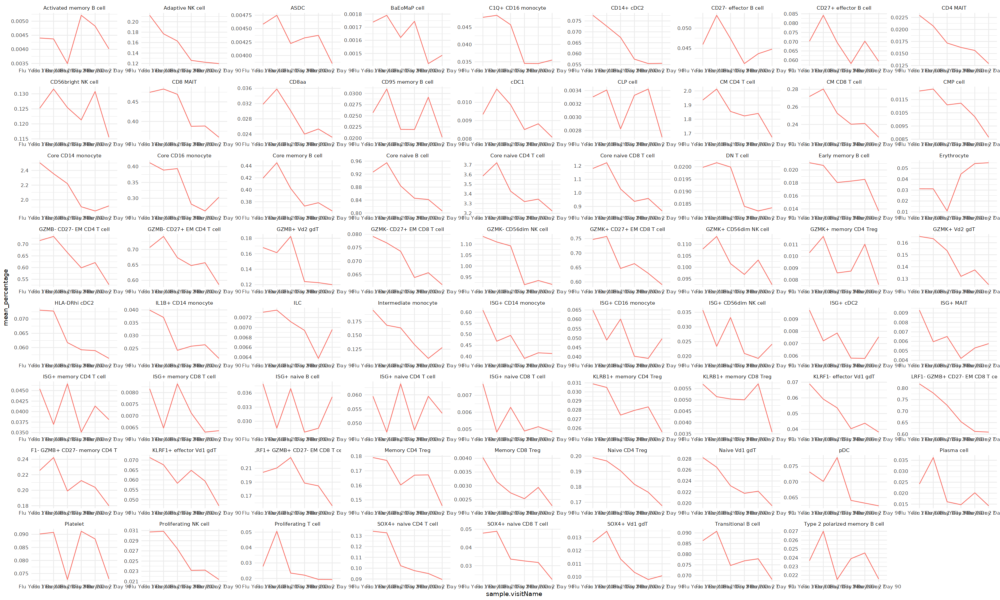

In [170]:
options(repr.plot.width = 25, repr.plot.height = 15)
ggplot(result_df_wo, aes(x = sample.visitName, y = mean_percentage, group = AIFI_L3, colour = "grey")) + 
  geom_line() +
  theme_minimal()+
  theme(legend.position = "none") +
  facet_wrap(~AIFI_L3, scales = 'free')

## Flu longitudinal

`summarise()` has grouped output by 'AIFI_L3'. You can override using the
`.groups` argument.


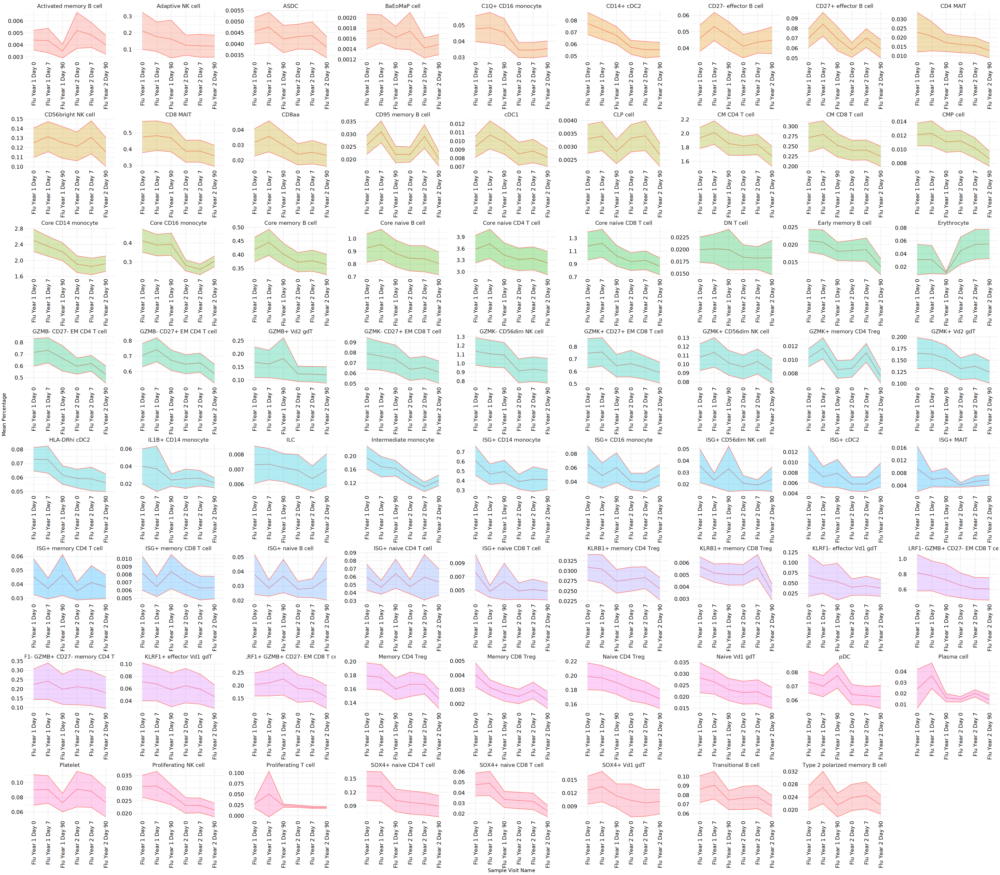

In [177]:

# Aggregate data to calculate mean and confidence intervals
summary_df <- result %>%
  dplyr::group_by(AIFI_L3, sample.visitName) %>%
  dplyr::summarise(mean_percentage = mean(percentage),
            ci_low = mean_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = mean_percentage + 1.96 * sd(percentage) / sqrt(n()))

# Plot with confidence intervals
options(repr.plot.width = 40, repr.plot.height = 35)
ggplot(summary_df, aes(x = sample.visitName, y = mean_percentage, color = "grey", group = AIFI_L3)) +
  geom_line() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = AIFI_L3), alpha = 0.3) +
  theme_minimal() +
  theme(strip.text = element_text(size = 15),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "none")+
  labs(x = "Sample Visit Name", y = "Mean Percentage", color = "AIFI_L3") + 
  facet_wrap(~AIFI_L3, scales = 'free')


## Flu longitudinal- Split by Age

`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


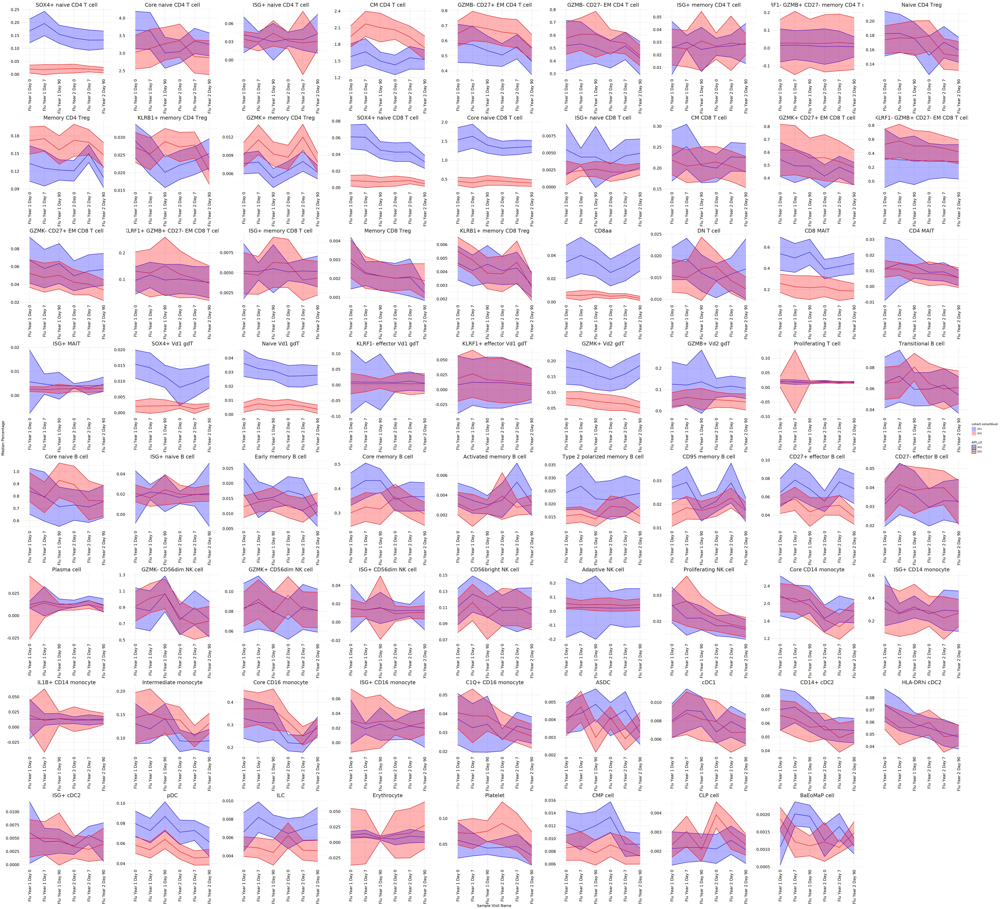

In [379]:
library(dplyr)
library(ggplot2)

# Assuming your dataframe is named 'df'

# Aggregate data to calculate mean and confidence intervals
summary_df <- result %>%
  dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width = 55, repr.plot.height = 50)
ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = cohort.cohortGuid), alpha = 0.3) +
  scale_fill_manual(values = c("BR1" = "blue", "BR2" = "red")) + 
  scale_color_manual(values = c("BR1" = "blue", "BR2" = "red"))+
  theme(strip.text = element_text(size = 20),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Median Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free') 


In [380]:
head(summary_df)

AIFI_L3,sample.visitName,cohort.cohortGuid,median_percentage,ci_low,ci_high
<fct>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
ASDC,Flu Year 1 Day 0,BR1,0.004111166,0.003250677,0.004971654
ASDC,Flu Year 1 Day 0,BR2,0.003913511,0.003092351,0.004734672
ASDC,Flu Year 1 Day 7,BR1,0.004373466,0.003369957,0.005376974
ASDC,Flu Year 1 Day 7,BR2,0.004740550,0.003858715,0.005622385
ASDC,Flu Year 1 Day 90,BR1,0.004873413,0.003996741,0.005750086
ASDC,Flu Year 1 Day 90,BR2,0.003003320,0.002157556,0.003849084


## Flu longitudinal- Split by CMV

`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


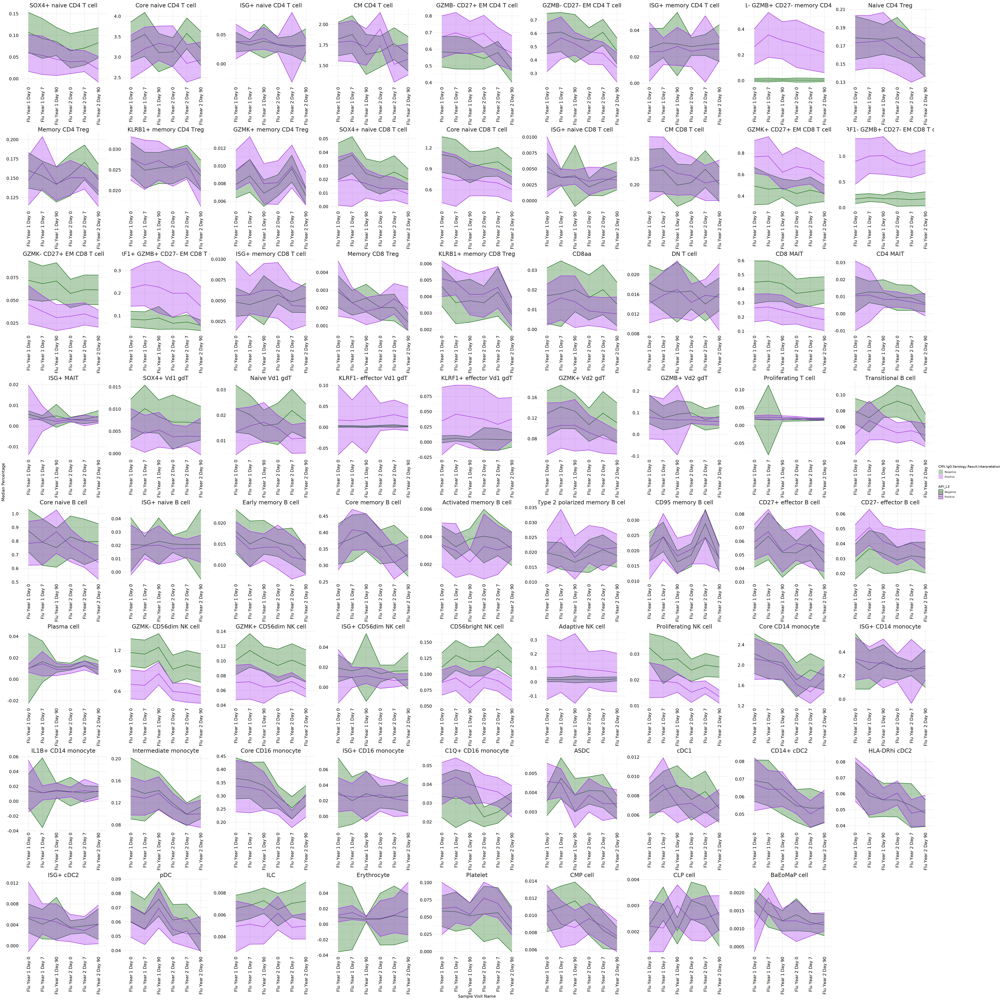

In [477]:
library(dplyr)
library(ggplot2)

# Assuming your dataframe is named 'df'

# Aggregate data to calculate mean and confidence intervals
summary_df <- result %>%
  dplyr::group_by(AIFI_L3, sample.visitName,CMV.IgG.Serology.Result.Interpretation ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width =50, repr.plot.height = 50)
ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = CMV.IgG.Serology.Result.Interpretation, group = CMV.IgG.Serology.Result.Interpretation)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, , fill = CMV.IgG.Serology.Result.Interpretation), alpha = 0.3) +
  scale_color_manual(values = c("Positive" = "purple", "Negative" = "darkgreen")) + 
  scale_fill_manual(values = c("Positive" = "purple", "Negative" = "darkgreen"))+
  theme(strip.text = element_text(size = 20),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Median Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free')


In [197]:
head(summary_df)

AIFI_L3,subject.subjectGuid,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>
ASDC,BR1001,Flu Year 1 Day 0,6,0.012381345,-2.014465,BR1,Female,Negative
ASDC,BR1001,Flu Year 1 Day 7,5,0.010317788,-2.196787,BR1,Female,Negative
ASDC,BR1001,Flu Year 1 Day 90,3,0.006190673,-2.707612,BR1,Female,Negative
ASDC,BR1002,Flu Year 1 Day 0,3,0.003233525,-2.497984,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 7,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 90,2,0.002155683,-2.903449,BR1,Male,Negative


## Flu longitudinal- Split by Sex

`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


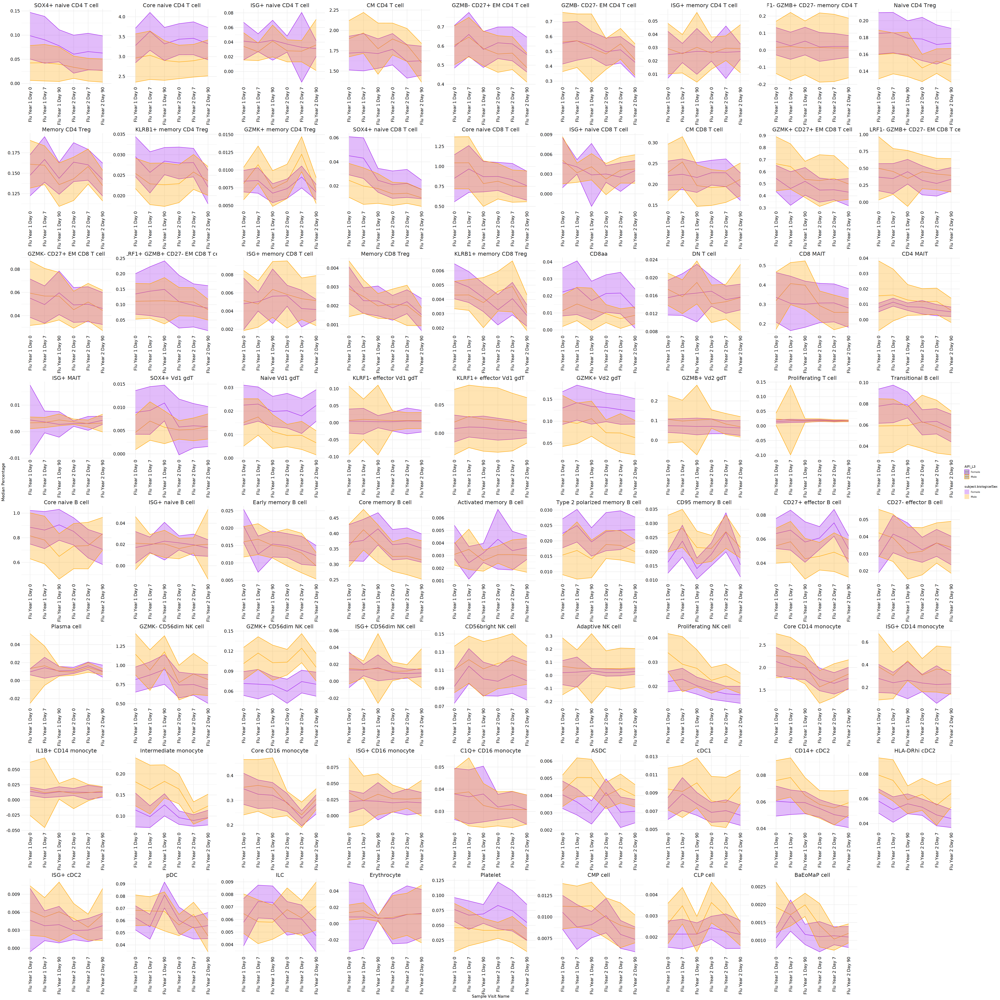

In [479]:
library(dplyr)
library(ggplot2)


# Aggregate data to calculate mean and confidence intervals
summary_df <- result %>%
  dplyr::group_by(AIFI_L3, sample.visitName,subject.biologicalSex ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width = 50, repr.plot.height = 50)
ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = subject.biologicalSex, group = subject.biologicalSex)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = subject.biologicalSex), alpha = 0.3) +
  scale_color_manual(values = c("Male" = "orange", "Female" = "purple")) + 
  scale_fill_manual(values = c("Male" = "orange", "Female" = "purple")) +
  theme(strip.text = element_text(size = 19),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Median Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free')


## Flu longitudinal- Split by Sex (Male ONLY)

In [490]:
result_male <- result %>% filter(result$subject.biologicalSex == "Male")
head(result_male)

AIFI_L3,subject.subjectGuid,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>
ASDC,BR1002,Flu Year 1 Day 0,3,0.003233525,-2.497984,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 7,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 1 Day 90,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 0,3,0.003233525,-2.497984,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 7,2,0.002155683,-2.903449,BR1,Male,Negative
ASDC,BR1002,Flu Year 2 Day 90,3,0.003233525,-2.497984,BR1,Male,Negative


`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


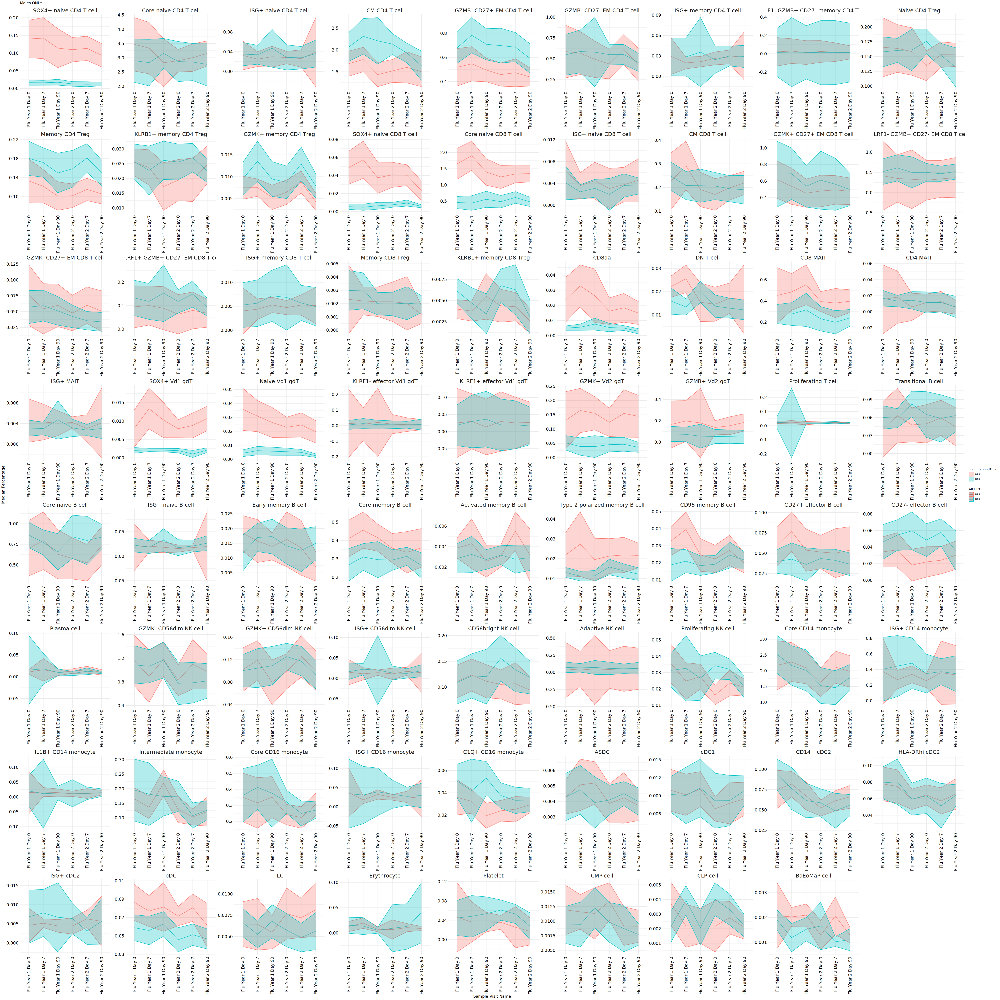

In [491]:
library(dplyr)
library(ggplot2)


# Aggregate data to calculate mean and confidence intervals
summary_df <- result_male %>%
  dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width = 50, repr.plot.height = 50)
ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = cohort.cohortGuid), alpha = 0.3) +
  #scale_color_manual(values = c("Male" = "blue", "Female" = "violet")) + 
  theme(strip.text = element_text(size = 19),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Median Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free')+ ggtitle("Males ONLY")





## Flu longitudinal- Split by Sex (Female ONLY)

In [484]:
result_female <- result %>% filter(result$subject.biologicalSex == "Female")
head(result_female)

AIFI_L3,subject.subjectGuid,sample.visitName,count,percentage,percentage_clr,cohort.cohortGuid,subject.biologicalSex,CMV.IgG.Serology.Result.Interpretation
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>
ASDC,BR1001,Flu Year 1 Day 0,6,0.012381345,-2.014465,BR1,Female,Negative
ASDC,BR1001,Flu Year 1 Day 7,5,0.010317788,-2.196787,BR1,Female,Negative
ASDC,BR1001,Flu Year 1 Day 90,3,0.006190673,-2.707612,BR1,Female,Negative
ASDC,BR1003,Flu Year 1 Day 0,4,0.004111166,-2.465101,BR1,Female,Negative
ASDC,BR1003,Flu Year 1 Day 7,1,0.001027791,-3.851395,BR1,Female,Negative
ASDC,BR1003,Flu Year 1 Day 90,1,0.001027791,-3.851395,BR1,Female,Negative


`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


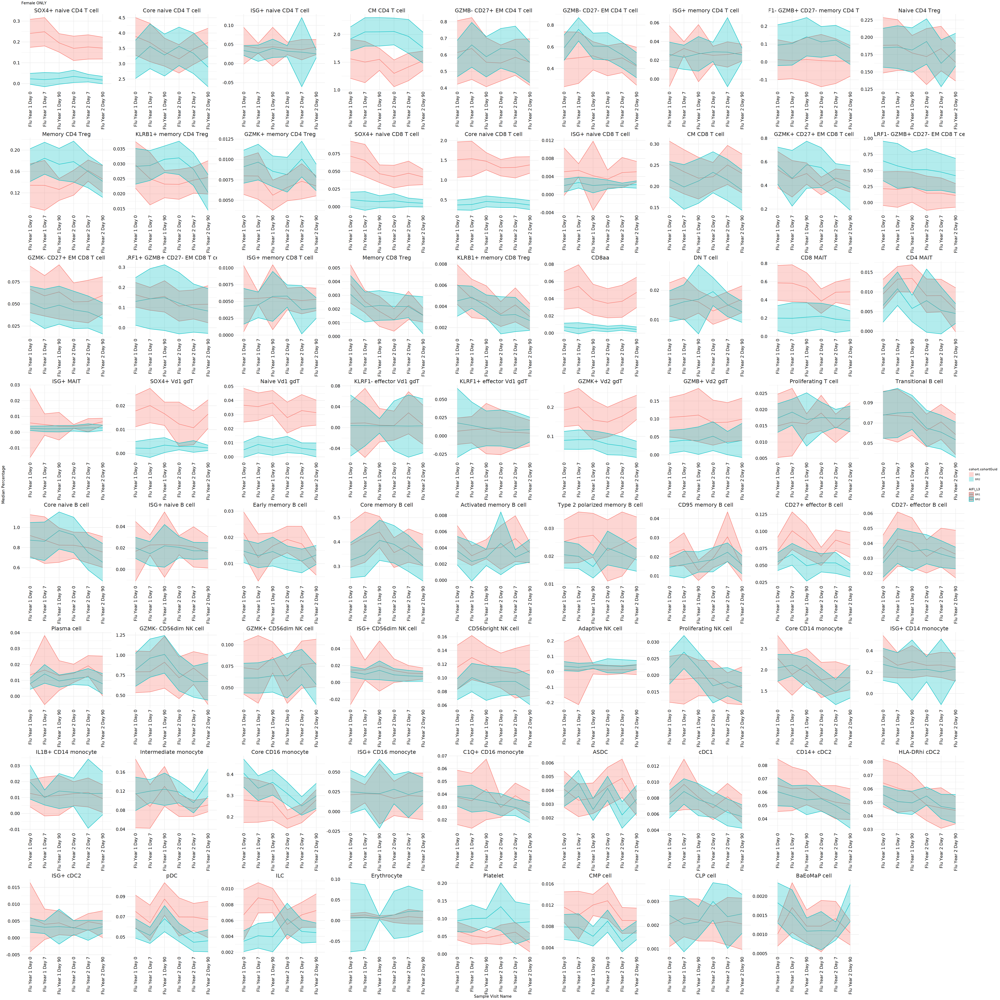

In [489]:
library(dplyr)
library(ggplot2)


# Aggregate data to calculate mean and confidence intervals
summary_df <- result_female %>%
  dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
  dplyr::summarise(median_percentage = median(percentage),
            ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
            ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

# Plot with confidence intervals
options(repr.plot.width = 50, repr.plot.height = 50)
ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
  geom_line() +
  theme_minimal() +
  geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = cohort.cohortGuid), alpha = 0.3) +
  #scale_color_manual(values = c("Male" = "blue", "Female" = "violet")) + 
  theme(strip.text = element_text(size = 19),
                axis.text.x = element_text(color = "black",
                                           size = 15,
                                           angle = 90,
                                           hjust = 1,
                                           vjust = 0.5),
                axis.text.y = element_text(color = "black", size = 15),
                axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                axis.title.y = element_text(size = 14),
                legend.position = "right")+
  labs(x = "Sample Visit Name", y = "Median Percentage", color = "AIFI_L3") + 
  facet_wrap(~ AIFI_L3, scales = 'free')+ ggtitle("Female ONLY")





## Flu longitudinal- Split by Age (no facet_wrap)

In [351]:
unique(result$AIFI_L3)
head(unique_celltypes)
nrow(result)

[1] "ASDC"                                
 [2] "Activated memory B cell"             
 [3] "Adaptive NK cell"                    
 [4] "BaEoMaP cell"                        
 [5] "C1Q+ CD16 monocyte"                  
 [6] "CD14+ cDC2"                          
 [7] "CD27+ effector B cell"               
 [8] "CD27- effector B cell"               
 [9] "CD4 MAIT"                            
[10] "CD56bright NK cell"                  
[11] "CD8 MAIT"                            
[12] "CD8aa"                               
[13] "CD95 memory B cell"                  
[14] "CLP cell"                            
[15] "CM CD4 T cell"                       
[16] "CM CD8 T cell"                       
[17] "CMP cell"                            
[18] "Core CD14 monocyte"                  
[19] "Core CD16 monocyte"                  
[20] "Core memory B cell"                  
[21] "Core naive B cell"                   
[22] "Core naive CD4 T cell"               
[23] "Core naive CD8 T cell"               
[24] "DN T cell"                           
[25] "Early memory B cell"                 
[26] "Erythrocyte"                         
[27] "GZMB+ Vd2 gdT"                       
[28] "GZMB- CD27+ EM CD4 T cell"           
[29] "GZMB- CD27- EM CD4 T cell"           
[30] "GZMK+ CD27+ EM CD8 T cell"           
[31] "GZMK+ CD56dim NK cell"               
[32] "GZMK+ Vd2 gdT"                       
[33] "GZMK+ memory CD4 Treg"               
[34] "GZMK- CD27+ EM CD8 T cell"           
[35] "GZMK- CD56dim NK cell"               
[36] "HLA-DRhi cDC2"                       
[37] "IL1B+ CD14 monocyte"                 
[38] "ILC"                                 
[39] "ISG+ CD14 monocyte"                  
[40] "ISG+ CD16 monocyte"                  
[41] "ISG+ CD56dim NK cell"                
[42] "ISG+ MAIT"                           
[43] "ISG+ cDC2"                           
[44] "ISG+ memory CD4 T cell"              
[45] "ISG+ memory CD8 T cell"              
[46] "ISG+ naive B cell"                   
[47] "ISG+ naive CD4 T cell"               
[48] "ISG+ naive CD8 T cell"               
[49] "Intermediate monocyte"               
[50] "KLRB1+ memory CD4 Treg"              
[51] "KLRB1+ memory CD8 Treg"              
[52] "KLRF1+ GZMB+ CD27- EM CD8 T cell"    
[53] "KLRF1+ effector Vd1 gdT"             
[54] "KLRF1- GZMB+ CD27- EM CD8 T cell"    
[55] "KLRF1- GZMB+ CD27- memory CD4 T cell"
[56] "KLRF1- effector Vd1 gdT"             
[57] "Memory CD4 Treg"                     
[58] "Memory CD8 Treg"                     
[59] "Naive CD4 Treg"                      
[60] "Naive Vd1 gdT"                       
[61] "Plasma cell"                         
[62] "Platelet"                            
[63] "Proliferating NK cell"               
[64] "Proliferating T cell"                
[65] "SOX4+ Vd1 gdT"                       
[66] "SOX4+ naive CD4 T cell"              
[67] "SOX4+ naive CD8 T cell"              
[68] "Transitional B cell"                 
[69] "Type 2 polarized memory B cell"      
[70] "cDC1"                                
[71] "pDC"

[1] "ASDC"                    "Activated memory B cell"
[3] "Adaptive NK cell"        "BaEoMaP cell"           
[5] "C1Q+ CD16 monocyte"      "CD14+ cDC2"

[1] 34833

In [224]:
for(cell in unique(result$AIFI_L3)){
    
    print(cell)
    
    #rm(cell_df, result_final)
    
    cell_df <- result %>% dplyr::filter(AIFI_L3 == cell)
    
    # Aggregate data to calculate mean and confidence intervals
    summary_df <- cell_df %>%
      dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
      dplyr::summarise(mean_percentage = mean(percentage),
                ci_low = mean_percentage - 1.96 * sd(percentage) / sqrt(n()),
                ci_high = mean_percentage + 1.96 * sd(percentage) / sqrt(n()))

    summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

    # Plot with confidence intervals
    options(repr.plot.width = 25, repr.plot.height = )
    ggplot(summary_df, aes(x = sample.visitName, y = mean_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
      geom_line() +
      theme_minimal() +
      geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = AIFI_L3), alpha = 0.3, fill = "grey80") +
      scale_color_manual(values = c("BR1" = "blue", "BR2" = "red")) + 
      theme(strip.text = element_text(size = 15),
                    axis.text.x = element_text(color = "black",
                                               size = 15,
                                               angle = 90,
                                               hjust = 1,
                                               vjust = 0.5),
                    axis.text.y = element_text(color = "black", size = 15),
                    axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                    axis.title.y = element_text(size = 14),
                    legend.position = "right")+
      labs(x = cell, y = "Mean Percentage", color = "AIFI_L3") + 
      #facet_wrap(~ AIFI_L3, scales = 'free')

}

ERROR: Error in parse(text = x, srcfile = src): <text>:38:1: unexpected '}'
37: 
38: }
    ^


`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


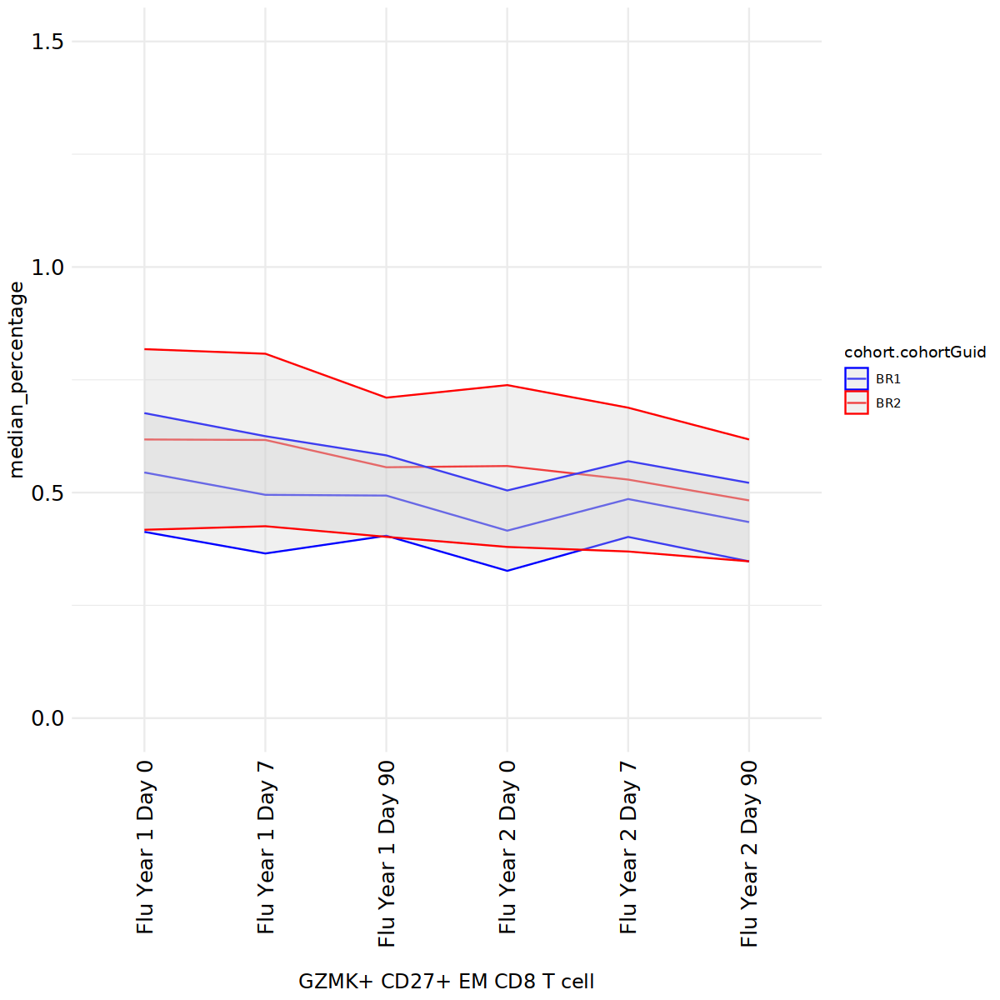

In [366]:
cell_df <- result %>% dplyr::filter(AIFI_L3 == "GZMK+ CD27+ EM CD8 T cell")
    
    # Aggregate data to calculate mean and confidence intervals
    summary_df <- cell_df %>%
      dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
      dplyr::summarise(median_percentage = median(percentage),
                ci_low = median_percentage - 1.96 * sd(percentage) / sqrt(n()),
                ci_high = median_percentage + 1.96 * sd(percentage) / sqrt(n()))

    summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

    # Plot with confidence intervals
    options(repr.plot.width = 10, repr.plot.height = 10)
    ggplot(summary_df, aes(x = sample.visitName, y = median_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
      geom_line() +
      theme_minimal() +
      geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = AIFI_L3), alpha = 0.3, fill = "grey80") +
      scale_color_manual(values = c("BR1" = "blue", "BR2" = "red")) + 
      theme(strip.text = element_text(size = 15),
                    axis.text.x = element_text(color = "black",
                                               size = 15,
                                               angle = 90,
                                               hjust = 1,
                                               vjust = 0.5),
                    axis.text.y = element_text(color = "black", size = 15),
                    axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                    axis.title.y = element_text(size = 14),
                    legend.position = "right")+ xlab("\nGZMK+ CD27+ EM CD8 T cell")+coord_cartesian(ylim = c(0, 1.5))

`summarise()` has grouped output by 'AIFI_L3', 'sample.visitName'. You can
override using the `.groups` argument.


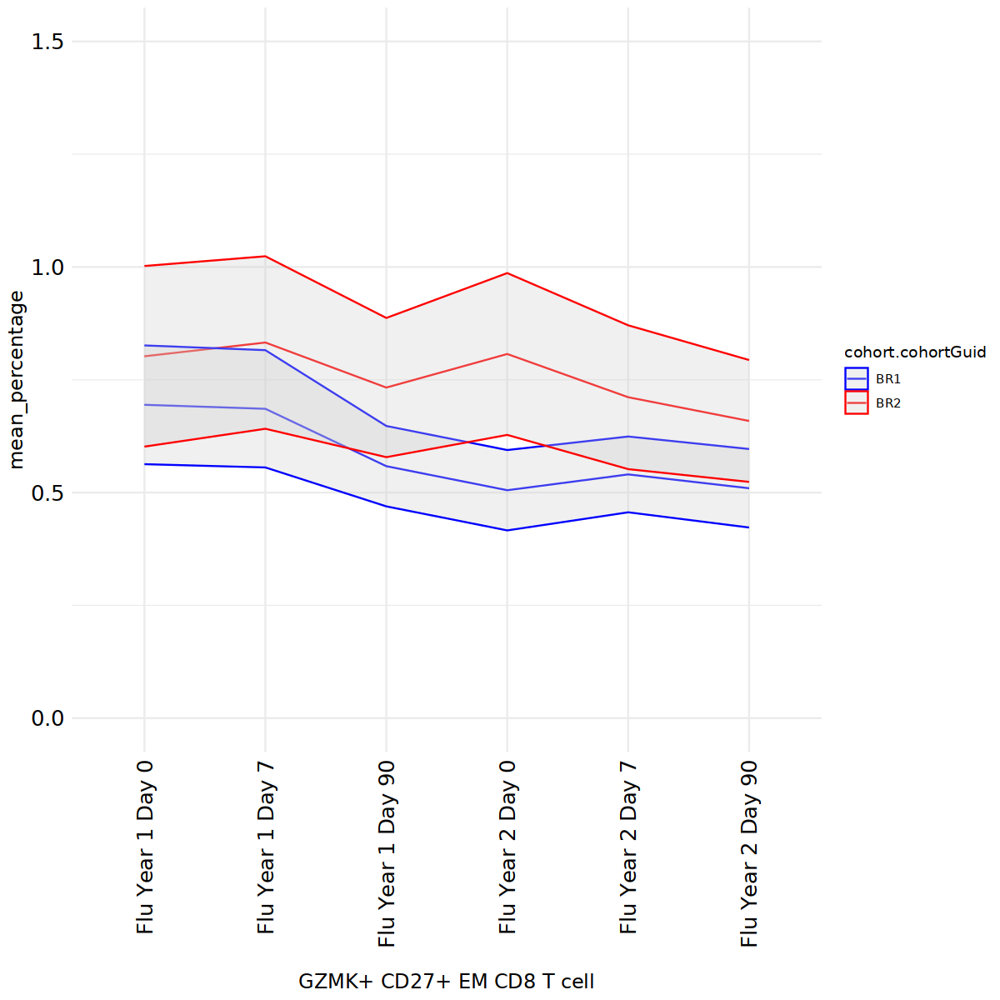

In [365]:
cell_df <- result %>% dplyr::filter(AIFI_L3 == "GZMK+ CD27+ EM CD8 T cell")
    
    # Aggregate data to calculate mean and confidence intervals
    summary_df <- cell_df %>%
      dplyr::group_by(AIFI_L3, sample.visitName,cohort.cohortGuid ) %>%
      dplyr::summarise(mean_percentage = mean(percentage),
                ci_low = mean_percentage - 1.96 * sd(percentage) / sqrt(n()),
                ci_high = mean_percentage + 1.96 * sd(percentage) / sqrt(n()))

    summary_df$AIFI_L3 <- factor(summary_df$AIFI_L3, levels = desired_labels)

    # Plot with confidence intervals
    options(repr.plot.width = 10, repr.plot.height = 10)
    ggplot(summary_df, aes(x = sample.visitName, y = mean_percentage, color = cohort.cohortGuid, group = cohort.cohortGuid)) +
      geom_line() +
      theme_minimal() +
      geom_ribbon(aes(ymin = ci_low, ymax = ci_high, fill = AIFI_L3), alpha = 0.3, fill = "grey80") +
      scale_color_manual(values = c("BR2" = "red","BR1" = "blue")) + 
      theme(strip.text = element_text(size = 15),
                    axis.text.x = element_text(color = "black",
                                               size = 15,
                                               angle = 90,
                                               hjust = 1,
                                               vjust = 0.5),
                    axis.text.y = element_text(color = "black", size = 15),
                    axis.title.x = element_text(size = 14),  # Adjust the font size of x-axis title
                    axis.title.y = element_text(size = 14),
                    legend.position = "right")+ xlab("\nGZMK+ CD27+ EM CD8 T cell") +coord_cartesian(ylim = c(0, 1.5))